# Spectral Images Processing

An exploratory notebook about spectral images processing.

More information is available on [ACEScentral](https://acescentral.com/c/aces-development-acesnext/vwg-aces-gamut-mapping-working-group/).

*TODO*:

*

## Google Drive

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [0]:
OUTPUT_DIRECTORY = '/content/drive/My Drive/Fast.io/academy-vwg-gm-hyper-spectral-images.imfast.io'

## colour-science Requirements

In [0]:
!pip install colour-datasets
!pip install gdown
!pip install networkx

!python -c "import imageio;imageio.plugins.freeimage.download()"

!pip uninstall -y colour-science
!if ! [ -d "colour" ]; then git clone https://github.com/colour-science/colour; fi
!if [ -d "colour" ]; then cd colour && git fetch && git checkout develop && git pull && cd ..; fi

import sys
sys.path.append('colour')

!mkdir -p /content/downloads

  Using cached https://files.pythonhosted.org/packages/2e/b8/a25564da5f41a2d349afb3e95f8c5d7007231450bacf433a92301b073070/colour_science-0.3.15-py2.py3-none-any.whl
Uninstalling colour-science-0.3.15:
  Successfully uninstalled colour-science-0.3.15
Already on 'develop'
Your branch is up to date with 'origin/develop'.
Already up to date.


In [0]:
import colour
import colour_datasets
import colour.plotting
import matplotlib.pyplot as plt
import numpy as np
import random
import scipy.io
import re
import textwrap
import tqdm

colour.plotting.colour_style()

plt.style.use({'figure.figsize': (19.20, 10.80)})

colour.utilities.describe_environment();

*                                                                             *
*   Interpreter :                                                             *
*       python : 3.6.9 (default, Nov  7 2019, 10:44:02)                       *
*                [GCC 8.3.0]                                                  *
*                                                                             *
*   colour-science.org :                                                      *
*       colour : v0.3.15-17-g1de08205                                         *
*       colour-datasets : 0.1.0                                               *
*       colour-hdri : 0.1.6                                                   *
*                                                                             *
*   Runtime :                                                                 *
*       imageio : 2.4.1                                                       *
*       matplotlib : 3.1.3              

colour/colour/utilities/verbose.py:235: ColourWarning: "Adobe DNG Converter" is not available on your platform!
  warn(*args, **kwargs)


## Cameras Sensitivites Datasets

In [0]:
print(colour_datasets.datasets())

colour-science-datasets

Datasets : 16
Synced   : 2
URL      : https://zenodo.org/communities/colour-science-datasets/

Datasets
--------

[ ] 3269926 : Agfa IT8.7/2 Set
[x] 3245883 : Camera Spectral Sensitivity Database
[ ] 3367463 : Constant Hue Loci Data
[ ] 3362536 : Constant Perceived-Hue Data
[ ] 3270903 : Corresponding-Colour Datasets
[ ] 3269920 : Forest Colors
[ ] 3245875 : Labsphere SRS-99-020
[ ] 3269924 : Lumber Spectra
[ ] 3269918 : Munsell Colors Glossy (All) (Spectrofotometer Measured)
[ ] 3269916 : Munsell Colors Glossy (Spectrofotometer Measured)
[ ] 3269914 : Munsell Colors Matt (AOTF Measured)
[ ] 3269912 : Munsell Colors Matt (Spectrofotometer Measured)
[ ] 3245895 : New Color Specifications for ColorChecker SG and Classic Charts
[ ] 3252742 : Observer Function Database
[ ] 3269922 : Paper Spectra
[x] 3372171 : RAW to ACES Utility Data


In [0]:
CAMERA_SENSITIVITIES_DATABASE = colour_datasets.load(
    'Camera Spectral Sensitivity Database')
AMPAS_CAMERA_SENSITIVITIES_DATABASE = colour_datasets.load(
    'RAW to ACES Utility Data')

TRAINING_DATA = AMPAS_CAMERA_SENSITIVITIES_DATABASE['training']['190-patch']

COMPOSITE_CAMERA_SENSITIVITIES_DATABASE = CAMERA_SENSITIVITIES_DATABASE.copy()
COMPOSITE_CAMERA_SENSITIVITIES_DATABASE.update(
    AMPAS_CAMERA_SENSITIVITIES_DATABASE['camera'])

CAMERA_NAMES = sorted(COMPOSITE_CAMERA_SENSITIVITIES_DATABASE.keys())

print(CAMERA_NAMES)

['Canon 1DMarkIII', 'Canon 20D', 'Canon 300D', 'Canon 40D', 'Canon 500D', 'Canon 50D', 'Canon 5DMarkII', 'Canon 600D', 'Canon 60D', 'Hasselblad H2', 'Nikon D200', 'Nikon D3', 'Nikon D300s', 'Nikon D3X', 'Nikon D40', 'Nikon D50', 'Nikon D5100', 'Nikon D700', 'Nikon D80', 'Nikon D90', 'Nokia N900', 'Olympus E-PL2', 'Pentax K-5', 'Pentax Q', 'Phase One', 'Point Grey Grasshopper 50S5C', 'Point Grey Grasshopper2 14S5C', 'SONY NEX-5N', 'arri d21', 'canon eos 5d mark ii', 'canon powershot s90', 'canon xti', 'nikon d200', 'nikon d5100', 'nikon d70', 'nikon d700', 'nikon d7000', 'sony ilce-7rm2', 'sony ilce-7sm2']


## Image Download


Downloading an example image from https://personalpages.manchester.ac.uk/staff/d.h.foster/Hyperspectral_images_of_natural_scenes_02.html

In [0]:
![ -e "/content/downloads/scene5.zip" ] && echo "File has been downloaded, skipping!" || curl https://personalpages.manchester.ac.uk/staff/d.h.foster/Hyperspectral_images_of_natural_scenes_02_files/scene5.zip -o /content/downloads/scene5.zip
!unzip -o /content/downloads/scene5.zip -d /content/downloads

File has been downloaded, skipping!
Archive:  /content/downloads/scene5.zip
 extracting: /content/downloads/scene5.mat  


Extracting the data from the MATLAB .mat file.

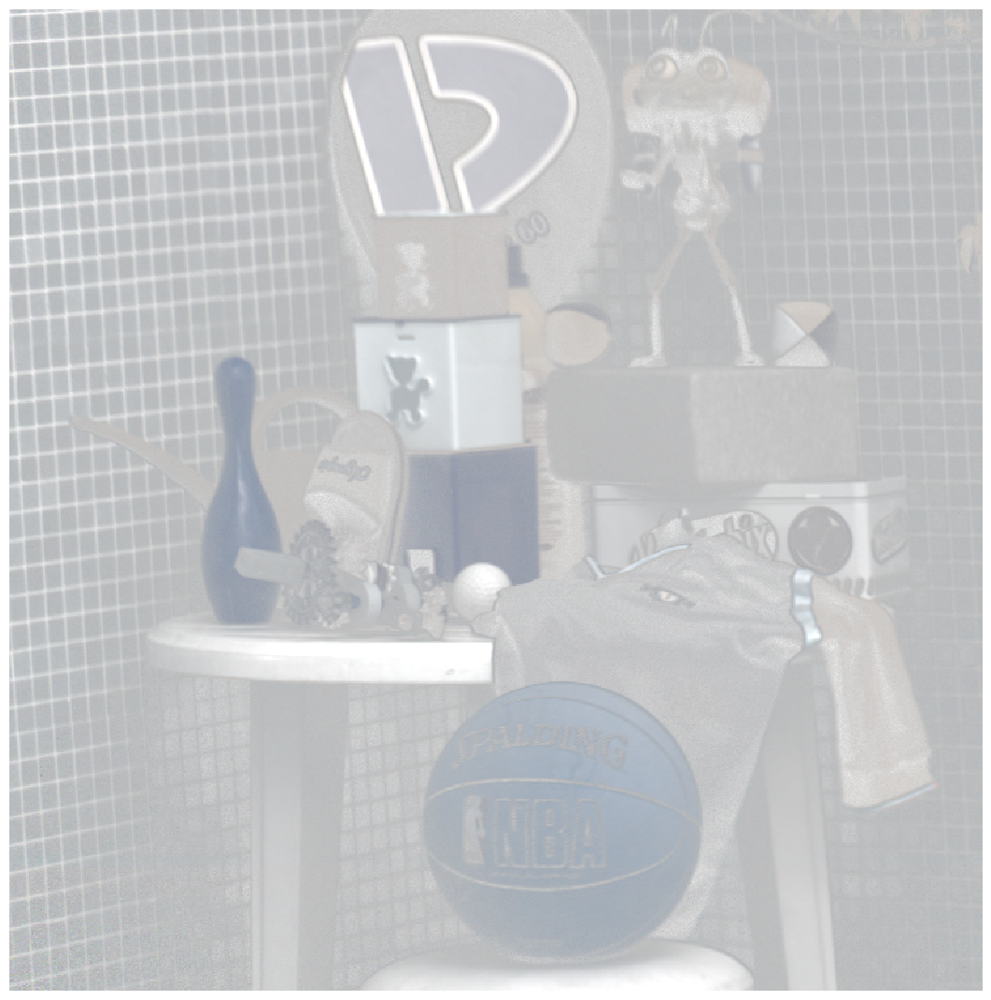

In [0]:
SPECTRAL_IMAGE = scipy.io.loadmat(
    '/content/downloads/scene5.mat')['reflectances']

colour.plotting.plot_image(colour.cctf_encoding(SPECTRAL_IMAGE[:, :, 15:19]));

## Observer & Camera Definitions

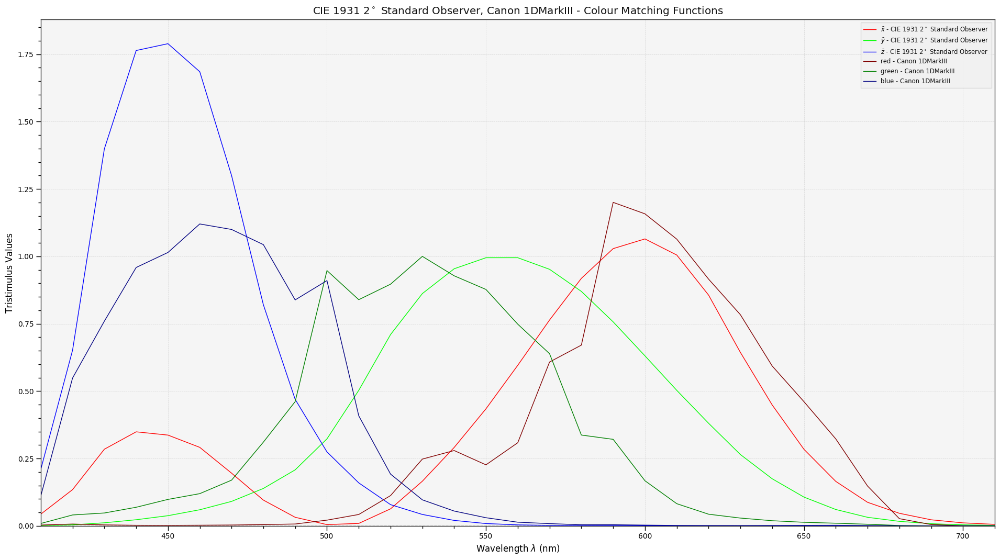

In [0]:
SHAPE = colour.SpectralShape(410, 710, 10)
WAVELENGTHS = SHAPE.range()


def normalise_multi_signal(multi_signal):
    multi_signal = multi_signal.copy()

    multi_signal.values = multi_signal.values / (
        colour.sd_to_XYZ(colour.sd_ones(), cmfs=multi_signal) / 100)

    return multi_signal


CMFS_NAME = 'CIE 1931 2 Degree Standard Observer'
CMFS = normalise_multi_signal(colour.CMFS[CMFS_NAME].copy().align(SHAPE))

COMPOSITE_CAMERA_SENSITIVITIES_DATABASE = {
    name: normalise_multi_signal(sensitivities.copy().align(SHAPE))
    for name, sensitivities in COMPOSITE_CAMERA_SENSITIVITIES_DATABASE.items()
}


colour.plotting.plot_multi_cmfs(
    [CMFS, COMPOSITE_CAMERA_SENSITIVITIES_DATABASE[CAMERA_NAMES[0]]]);

## Pseudo-IDT Matrices

In [0]:
ILLUMINANT_A = colour.ILLUMINANTS_SDS['A']
CCT_A = colour.uv_to_CCT(
    colour.xy_to_UCS_uv(colour.XYZ_to_xy(colour.sd_to_XYZ(ILLUMINANT_A))))[0]
ILLUMINANT_B = colour.ILLUMINANTS_SDS['D65']
CCT_B = colour.uv_to_CCT(
    colour.xy_to_UCS_uv(colour.XYZ_to_xy(colour.sd_to_XYZ(ILLUMINANT_B))))[0]

TRAINING_DATA_SDS = np.transpose(
    TRAINING_DATA.copy().interpolate(SHAPE).values)


def generate_IDT_matrix(cmfs, sensitivities, illuminant, training_sds):
    XYZ_r = colour.multi_sds_to_XYZ(
        training_sds,
        method='Integration',
        cmfs=cmfs,
        illuminant=illuminant,
        shape=SHAPE) / 100

    XYZ_t = colour.multi_sds_to_XYZ(
        training_sds,
        method='Integration',
        cmfs=sensitivities,
        illuminant=illuminant,
        shape=SHAPE) / 100

    M = colour.colour_correction_matrix(XYZ_t, XYZ_r)

    D = np.diag(np.tile(1 / np.sum(M[1]), 3))

    return colour.utilities.dot_matrix(M, D)


M_IDT_A = {
    camera: generate_IDT_matrix(CMFS, sensitivities, ILLUMINANT_A,
                                TRAINING_DATA_SDS)
    for camera, sensitivities in COMPOSITE_CAMERA_SENSITIVITIES_DATABASE.items()
}
M_IDT_B = {
    camera: generate_IDT_matrix(CMFS, sensitivities, ILLUMINANT_B,
                                TRAINING_DATA_SDS)
    for camera, sensitivities in COMPOSITE_CAMERA_SENSITIVITIES_DATABASE.items()
}

## LED Light Sources

colour/colour/utilities/verbose.py:235: ColourUsageWarning: "RGB_Colourspace.illuminant" object has been renamed to "RGB_Colourspace.whitepoint_name".
  warn(*args, **kwargs)


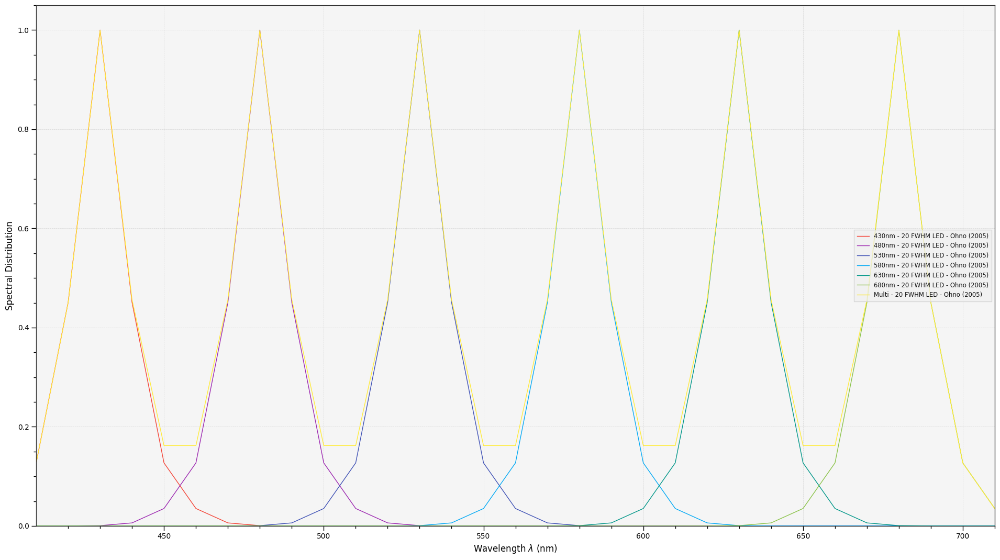

In [0]:
FWHM = 20
LED_WAVELENGTHS = np.arange(SHAPE.start + FWHM, SHAPE.end - FWHM, 50)

LIGHT_SOURCES = {
    i: colour.sd_single_led(i, FWHM).align(SHAPE)
    for i in LED_WAVELENGTHS
}
LIGHT_SOURCE_W = colour.sd_multi_leds(LED_WAVELENGTHS,
                                        FWHM).align(SHAPE).normalise(1)
LIGHT_SOURCE_W.name = 'Multi - {0} FWHM LED - Ohno (2005)'.format(FWHM)

CCT_LIGHT_SOURCES = {
    name: colour.uv_to_CCT(
        colour.xy_to_UCS_uv(colour.XYZ_to_xy(
            colour.sd_to_XYZ(light_source))))[0]
    for name, light_source in LIGHT_SOURCES.items()
}

colour.plotting.plot_multi_sds(list(LIGHT_SOURCES.values()) + [LIGHT_SOURCE_W]);

## Camera Data Rendering

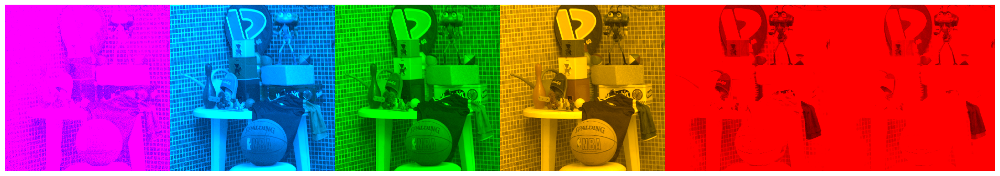

colour/colour/utilities/verbose.py:235: ColourUsageWarning: "OpenImageIO" related API features are not available, switching to "Imageio"!
  warn(*args, **kwargs)


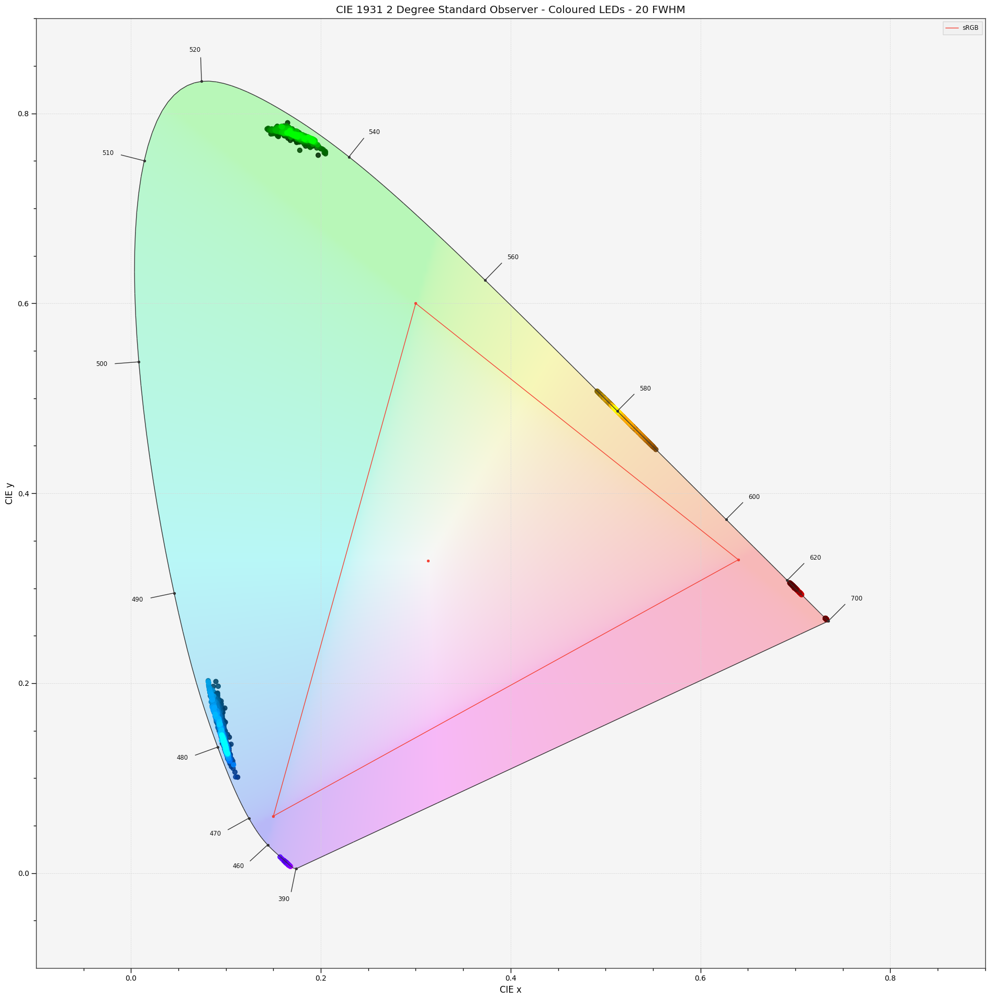

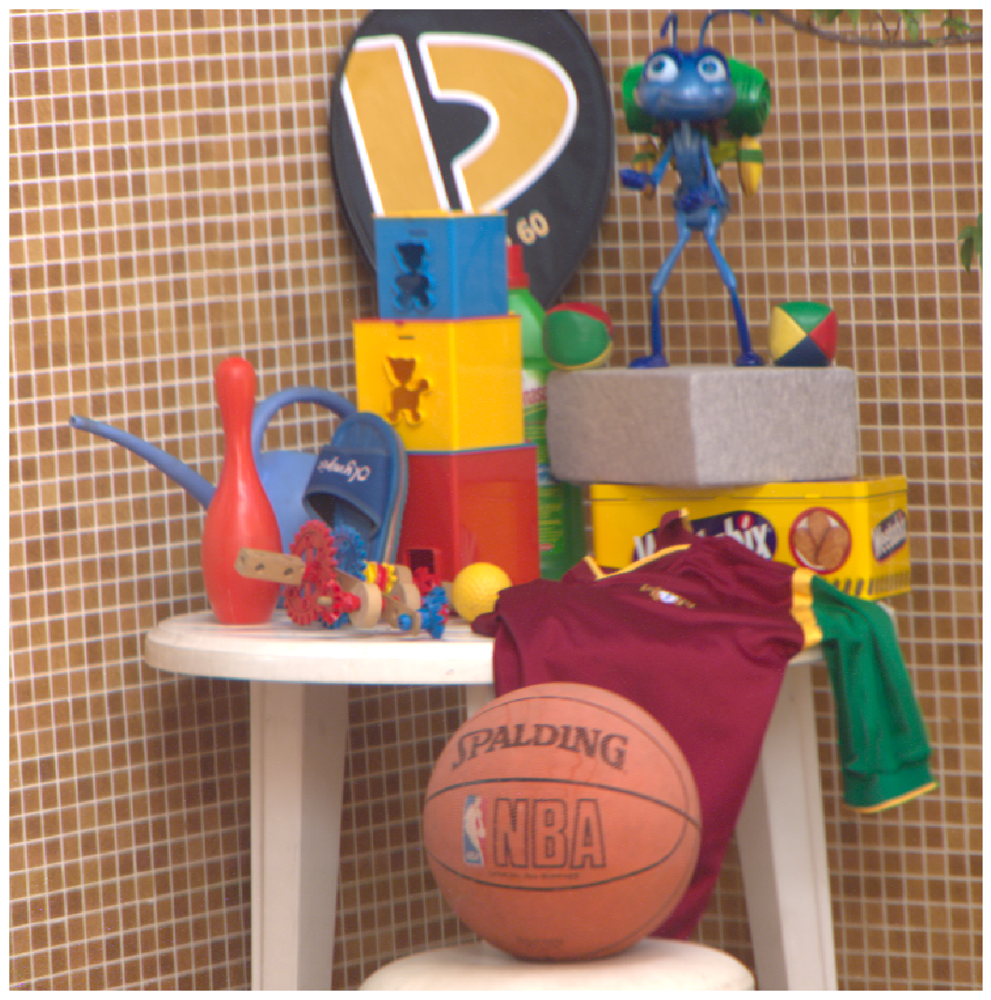

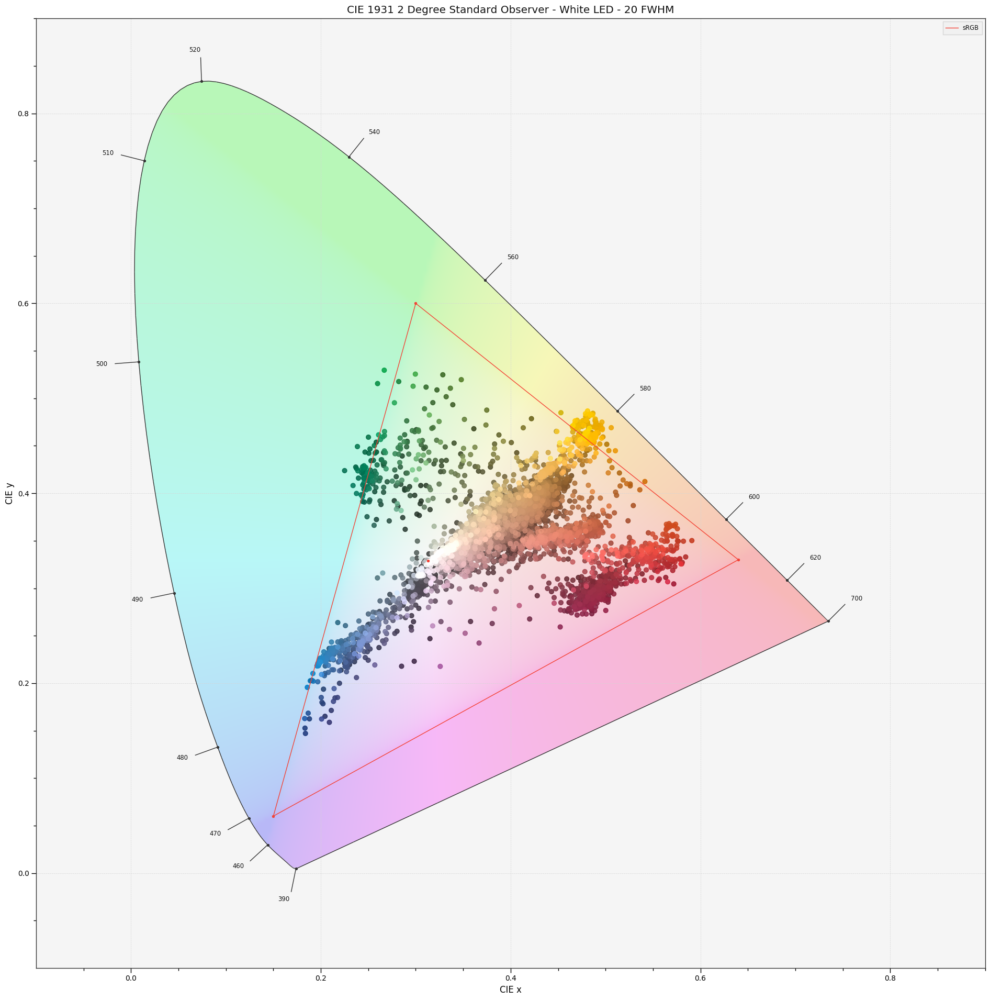

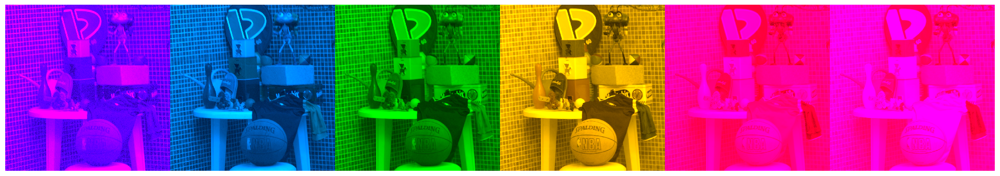

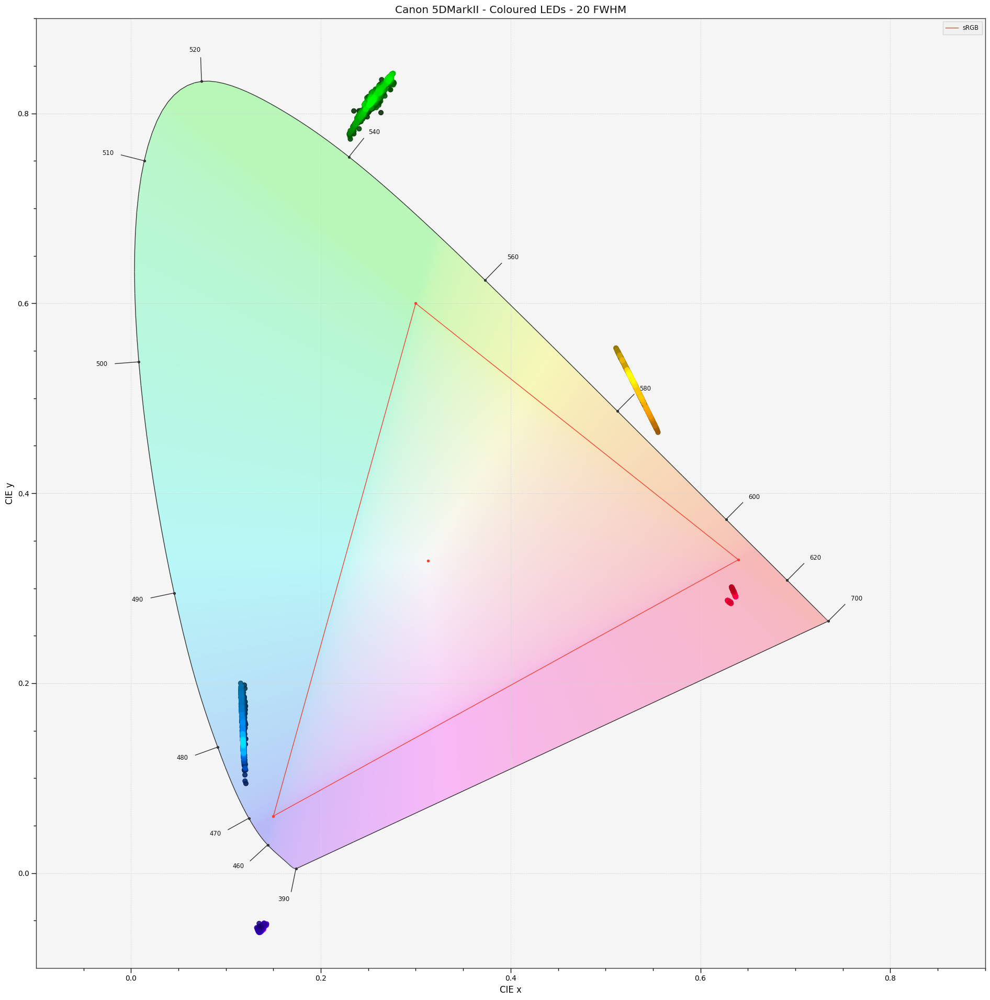

...

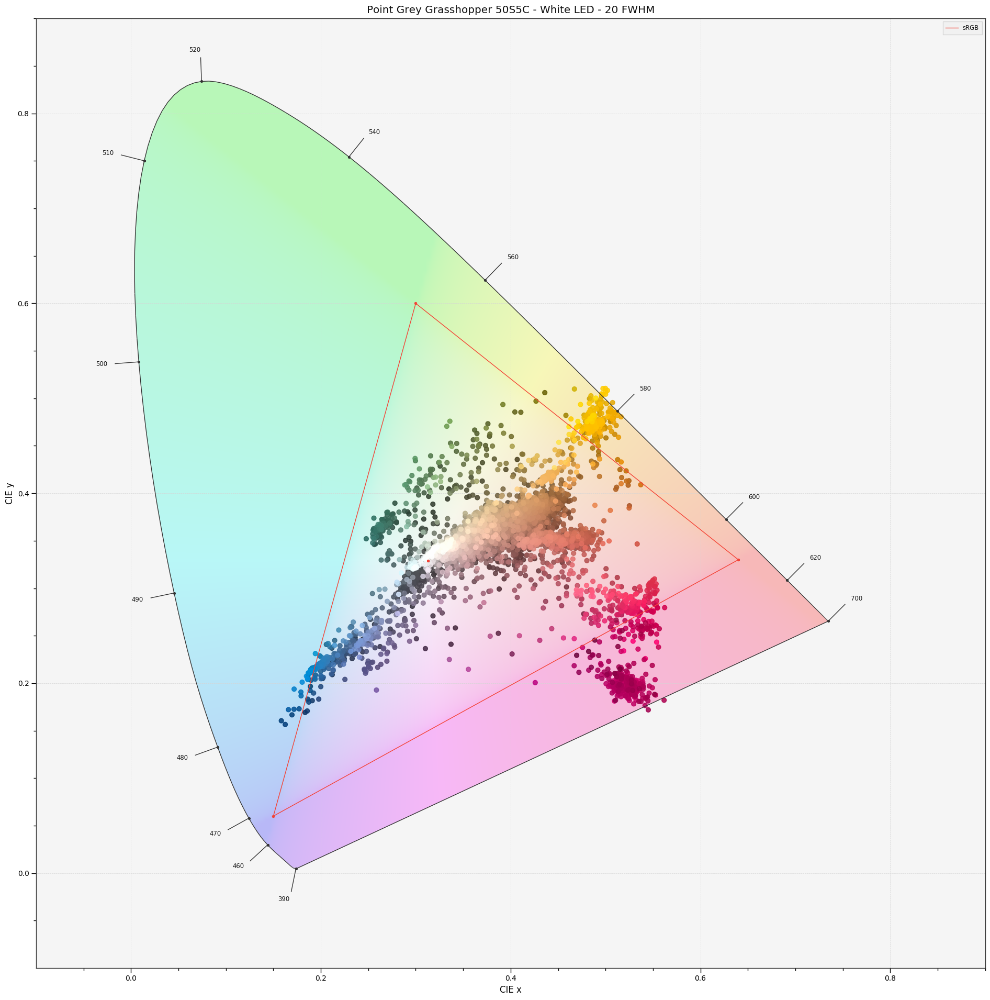

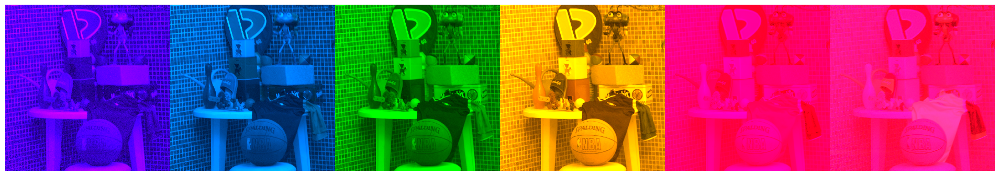

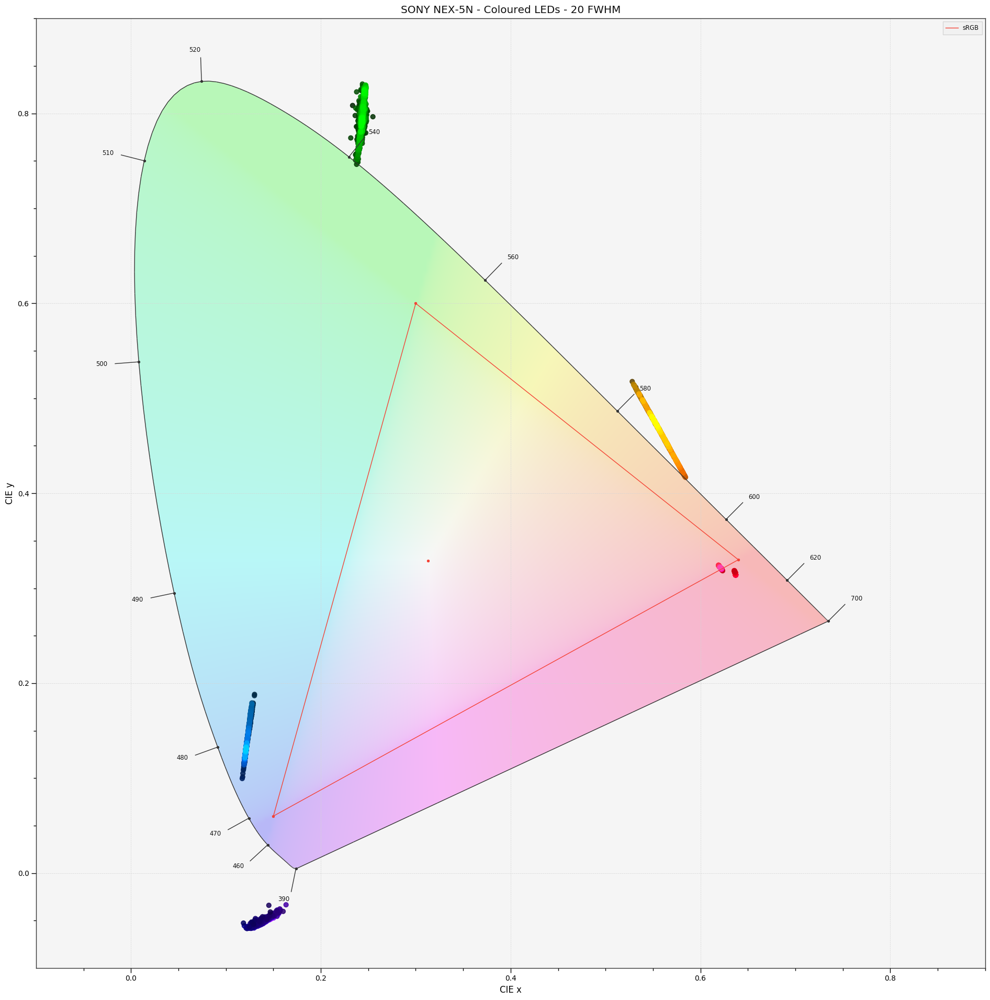

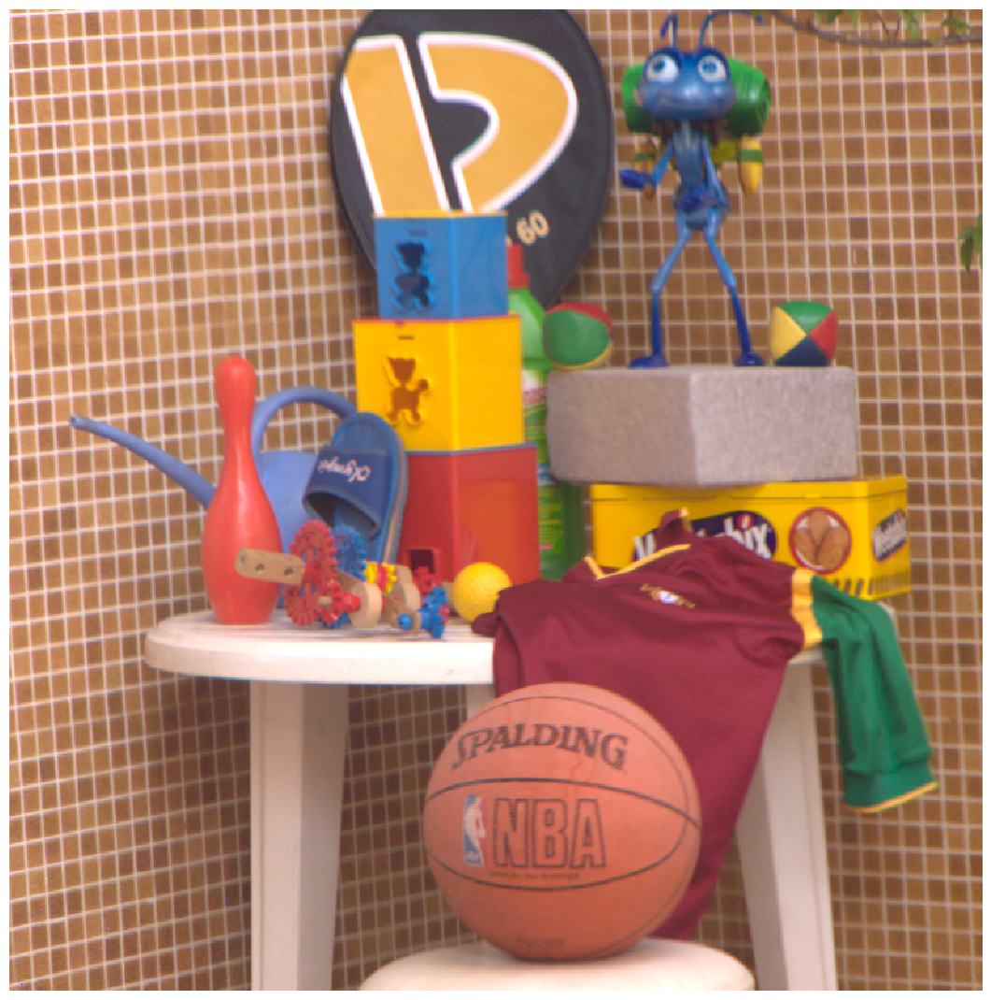

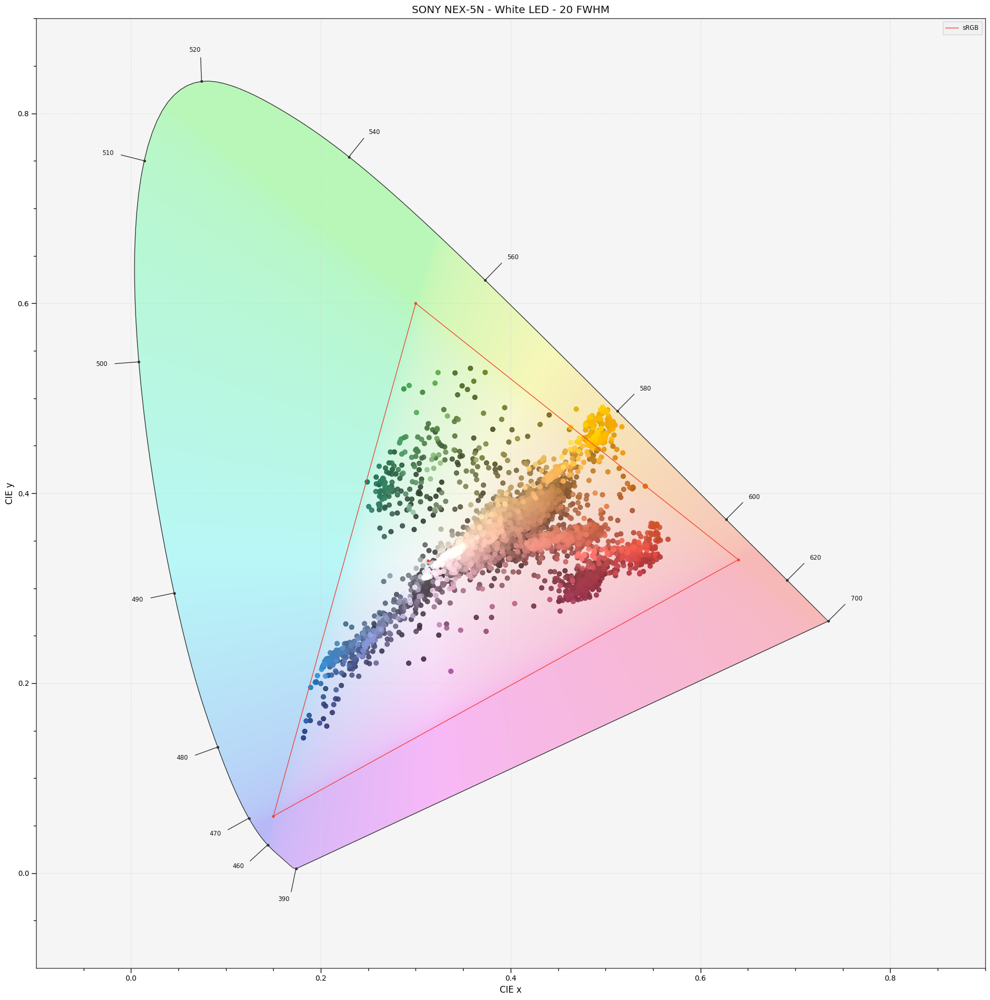

In [0]:
SELECTED_CAMERA_NAMES = [
    # 'Canon 1DMarkIII',
    # 'Canon 20D',
    # 'Canon 300D',
    # 'Canon 40D',
    # 'Canon 500D',
    # 'Canon 50D',
    'Canon 5DMarkII',
    # 'Canon 600D',
    # 'Canon 60D',
    'Hasselblad H2',
    # 'Nikon D200',
    'Nikon D3',
    # 'Nikon D300s',
    # 'Nikon D3X',
    # 'Nikon D40',
    # 'Nikon D50',
    # 'Nikon D5100',
    # 'Nikon D700',
    # 'Nikon D80',
    # 'Nikon D90',
    'Nokia N900',
    'Olympus E-PL2',
    'Pentax K-5',
    # 'Pentax Q',
    'Phase One',
    'Point Grey Grasshopper 50S5C',
    # 'Point Grey Grasshopper2 14S5C',
    'SONY NEX-5N',
    # 'arri d21',
    # 'canon eos 5d mark ii',
    # 'canon powershot s90',
    # 'canon xti',
    # 'nikon d200',
    # 'nikon d5100',
    # 'nikon d70',
    # 'nikon d700',
    # 'nikon d7000',
    # 'sony ilce-7rm2',
    # 'sony ilce-7sm2',
]


def concatenate_images(a, b):
    h_a, w_a = a.shape[:2]
    h_b, w_b = b.shape[:2]
    max_height = np.max([h_a, h_b])
    total_width = w_a + w_b

    c = np.zeros(shape=(max_height, total_width, 3))
    c[:h_a, :w_a] = a
    c[:h_b, w_a:w_a + w_b] = b

    return c


def slugify(a):
    return re.sub(r'(?u)[^-\w.]', '', str(a).strip().replace(' ', '_'))


def render_spectral_image(msds,
                          cmfs,
                          light_sources,
                          idt_matrix=None,
                          output_directory='{0}/images'.format(OUTPUT_DIRECTORY)):
    RGB_a = []
    for i, (name, light_source) in enumerate(light_sources.items()):
        XYZ = colour.multi_sds_to_XYZ(
            msds,
            method='Integration',
            cmfs=cmfs,
            illuminant=light_source,
            shape=cmfs.shape) / 100

        if idt_matrix is not None:
            XYZ = colour.utilities.dot_vector(idt_matrix, XYZ)

        RGB_a.append(colour.XYZ_to_sRGB(XYZ, apply_cctf_encoding=False))


    RGB = RGB_a[0]
    RGB_a = RGB_a[1:]
    for i in range(len(RGB_a)):
        RGB = concatenate_images(RGB, RGB_a[i])

    title = '{0} - {1}'.format(
        cmfs.name, '{0} - {1} FWHM'.format(
            'Coloured LEDs' if len(light_sources) > 1 else 'White LED', FWHM))
    colour.plotting.plot_image(colour.cctf_encoding(RGB))
    colour.write_image(RGB, '{0}/{1}.exr'.format(output_directory,
                                                 slugify(title)))
    colour.plotting.plot_RGB_chromaticities_in_chromaticity_diagram_CIE1931(
        RGB[::10, ::10, :],
        diagram_opacity=0.25,
        title=title,
        filename='{0}/{1}_Diagram.png'.format(output_directory,
                                              slugify(title)))


render_spectral_image(SPECTRAL_IMAGE, CMFS,
                      dict(list(LIGHT_SOURCES.items())))

render_spectral_image(SPECTRAL_IMAGE, CMFS, {'White': LIGHT_SOURCE_W})

for camera in SELECTED_CAMERA_NAMES:
    render_spectral_image(
        SPECTRAL_IMAGE, COMPOSITE_CAMERA_SENSITIVITIES_DATABASE[camera],
        dict(list(LIGHT_SOURCES.items())), M_IDT_B[camera])

    render_spectral_image(SPECTRAL_IMAGE,
                          COMPOSITE_CAMERA_SENSITIVITIES_DATABASE[camera],
                          {'White': LIGHT_SOURCE_W}, M_IDT_B[camera])

## Served Content

In [0]:
JS_JERI_CAMERA_DATA_TEMPLATE = """
const cameraData = {{
    title: 'root',
    children: [{camera_data}
    ]
}};"""[1:]

JS_JERI_CAMERA_TEMPLATE = """
{{
    title: '{camera_name}',
    children: [
        {{
            title: 'White LED',
            image: 'images/{slugified_camera_name}_-_White_LED_-_{fwhm}_FWHM.exr',
        }},
        {{
            title: 'MRSE',
            lossMap: {{
                'function': 'MRSE',
                imageA: 'images/CIE_1931_2_Degree_Standard_Observer_-_White_LED_-_{fwhm}_FWHM.exr',
                imageB: 'images/{slugified_camera_name}_-_White_LED_-_{fwhm}_FWHM.exr'
            }}
        }},
        {{
            title: 'Coloured LEDs',
            image: 'images/{slugified_camera_name}_-_Coloured_LEDs_-_{fwhm}_FWHM.exr',
        }},
        {{
            title: 'White LED - Diagram',
            image: 'images/{slugified_camera_name}_-_White_LED_-_{fwhm}_FWHM_Diagram.png',
        }},
        {{
            title: 'Coloured LEDs - Diagram',
            image: 'images/{slugified_camera_name}_-_Coloured_LEDs_-_{fwhm}_FWHM_Diagram.png',
        }}
    ]
}},"""


def generate_js_camera_payload(cameras, output_directory=OUTPUT_DIRECTORY):
    camera_data = textwrap.indent(JS_JERI_CAMERA_TEMPLATE.format(
        **{
            'camera_name': 'Observer',
            'slugified_camera_name': slugify(CMFS_NAME),
            'fwhm': FWHM,
        }), 8 * ' ')
    
    for camera in cameras:
        camera_data += textwrap.indent(JS_JERI_CAMERA_TEMPLATE.format(
            **{
                'camera_name': camera,
                'slugified_camera_name': slugify(camera),
                'fwhm': FWHM,
            }), 8 * ' ')

    with open('{0}/hyper-spectral-images.js'.format(
        output_directory), 'w') as js_camera_payload:
        js_camera_payload.write(
            JS_JERI_CAMERA_DATA_TEMPLATE.format(
                **{'camera_data': camera_data}))
        

generate_js_camera_payload(SELECTED_CAMERA_NAMES)